##schimaski ed or vanno a impostare il sistema di 4 eq e 4 inc. 
il passaggio da traspirazione potenziale a effettiva si fa direttamente dentro 
il sistema non si va a fare il prodotto. si possono accendere e spegnere gli stress,ma il bilancio consiste nel sistema e considera direttamente la trspirazione effettiva.
Abbiamo considerato il soilMoisture18 perchè all'altro mancavano metà dati, quindi abbiamo utilizzato questo invinetato in cui a tutti i tempi il contenuto d'acqua è costante.

# **GEOET - Prospero**

- Author Concetta D'Amato, Niccolò Tubini, Michele Bottazzi and Riccardo Rigon 

This work is licensed under a Creative Commons Attribution-NonCommercial 4.0 International License
____

### *What about Prospero*

Bottazzi, Michele. n.d. “[Transpiration Theory and the Prospero Component of GEOframe](https://paperpile.com/shared/yN2wjv).” Supervised by R. Rigon and G. Bertoldi. Ph.D., Civil, Environmental and Mechanical Engineering of University of Trento. 

More informations http://abouthydrology.blogspot.com/2020/07/michele-bottazzi-phd-thesis.html

In [1]:
import os
import warnings
import datetime
import warnings
import numpy as np
import pandas as pd
import xarray as xr
from matplotlib import rc
import plotly.express as px
import matplotlib.pyplot as plt
import matplotlib.style as style
import matplotlib.dates as mdates
from IPython.display import Image
from GEOSPACE_Output import*
warnings.filterwarnings('ignore')
warnings.simplefilter(action='ignore', category=FutureWarning)
oms_project_path = os.path.dirname(os.getcwd())

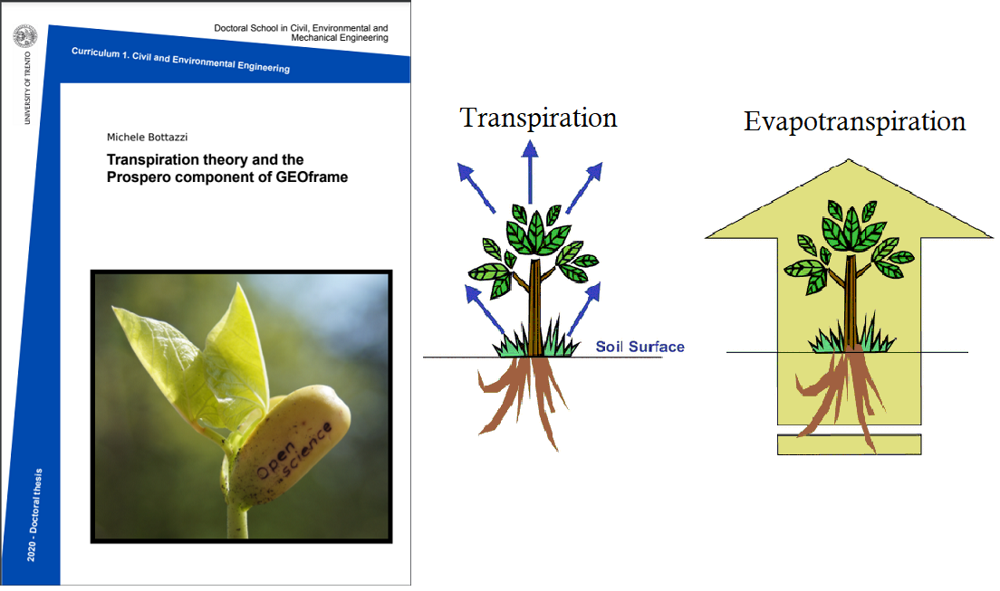

In [2]:
Image(oms_project_path+"/Images/Pro.png")

## **Transpiration**

In Prospero the transpiration is computed starting from the [Schymanski and Or method](https://hess.copernicus.org/articles/21/685/2017/)  and modified in order to include the dependence from transpiring surface, the conductance model of the stomata, other than the mass conservation.  

Prospero solves a four linear equation system and compute the leaf temperature, the vapour pressure, the sensible heat and the latent heat:

\begin{equation}
   \begin{cases}
   T_{\Delta}=\frac{\gamma}{a_{sH}\ C_{Dr}\gamma+a_{sE}\ C_{Da}\Delta_{e{T}}}\cdot\frac{R_{s}-R_{ll}-S_{nk}}{\rho_{a} \bar u c_{p}}-\frac{C_{Da}}{a_{sH}\ C_{Dr}\gamma+a_{sE}\ C_{Da}\Delta_{e{T}}}\cdot \delta e(z)\\e_{\Delta}=\frac{\gamma\Delta_{e{T}}}{a_{sH}\ C_{Dr}\gamma+a_{sH}\ C_{Da}\Delta_{e{T}}}\cdot\frac{R_{s}-R_{ll}-S_{nk}}{\rho_{a} \bar u c_{p}}-\frac{a_{sH}\ C_{Dr}\gamma+(a_{sE}-1)\ C_{Da}\Delta_{e{T}}}{a_{sH}\ C_{Dr}\gamma+a_{sH}\ C_{Da}\Delta_{e{T}}}\cdot \delta e(z)\\H=\frac{C_{Dr}\gamma}{a_{sH} C_{Dr}\gamma+a_{sE}C_{Da}\Delta_{e{T}}}\cdot(R_{s}-R_{ll}-S_{nk})+\frac{\rho_{a}\bar u\ c_{p}\ C_{Dr}\ C_{Da}}{a_{sH}\ C_{Dr}\gamma+a_{sE}\ C_{Da}\Delta_{e{T}}}\cdot \delta e(z)\\\lambda E_{T}=\frac{C_{Da}\Delta_{e{T}}}{ C_{Dr}\gamma+a_{sE}C_{Da}\Delta_{e{T}}}\cdot(R_{s}-R_{ll}-S_{nk})+\frac{\rho_{a}\bar u\ c_{p}\ a_{sE}\ C_{Dr}\ C_{Da}\ +(a_{sE}-1)\ C_{Da}^2\Delta_{e{T}}\gamma^{-1} }{a_{sH}\ C_{Dr}\gamma+a_{sE}\ C_{Da}\Delta_{e{T}}}\cdot \delta e(z)
   \end{cases} 
\end{equation}

Prospero computes the actual evapotranspiration multiplying the Potential Evapotranspiration for a total stress factor $g_{s}$.
\begin{equation}
ET_{eff}=ET_{pot}\cdot g_{s}
\end{equation}

\begin{equation}
g_{s} = g_{s}max\cdot f(R_{par})\cdot f(T_{a})\cdot f(VPD) \cdot K_{s}
\end{equation}

where:
- $g_{s}max $ is the conductance without any kind of stress and in well-watered conditions;
- $f(R_{par})$ is the stress coefficient as a function of photosynthetically active radiation;
- $f(T_{a})$ is the stress coefficient as a function of the air temperature;
- $f(VPD) $ is the stress coefficient as a function of the vapor pressure deficit;
- $K_{s} $ is the stress coefficient as a function of the water content.

## Input required:
- Dem
- Centroids
- Air temperature
- Wind velocity
- Relative humidity
- Shortwave direct radiation
- Shortwave diffuse radiation
- Longwave radiation
- Net Radiation
- Atmospheric pressure
- Leaf Area Index (LAI)
- Soil water content
- Ground Heat Flux

## Prospero model Output

- Latent heat both for sunlight and shaded canopy [$W/m^{2}$];
- Traspiration flux [$W/m^{2}$];
- Transpiration [$mm$];
- Leaves temperature both for sunlight and shaded canopy [$W/m^{2}$];
- Sensible heat both for sunlight and shaded canopy [$W/m^{2}$];
- Fraction of highlighted canopy [-];
- Shortwave radiation absorbed both for sunlight and shaded canopy [$W/m^{2}$];

In [3]:
os.chdir(oms_project_path+'/output/Cavone/1')
#os.listdir()

### **Transpiration  $[W m^{−2}]$**

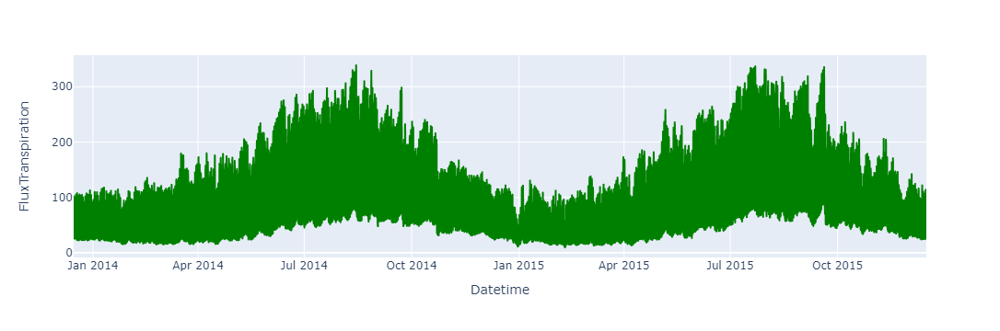

In [4]:
df2 = pd.read_csv('FluxTranspiration_1_potential.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df2.columns = ['Datetime','FluxTranspiration']
fig = px.line(df2, x='Datetime', y='FluxTranspiration')
fig.update_traces(line_color='green')
fig.show()

i primi tre stress (quindi tutti tranne quello dell'acqua) si possono definire degli stress ambientali e quindi è possibile ottenere la traspirazione ambientale

In [5]:
show_stress('FluxTranspiration_1_potential.csv',
            'FluxTranspiration_1_environmentalstress.csv',
            'FluxTranspiration_1_waterstress.csv',
            'FluxTranspiration_1_totalstress.csv')

In [6]:
show_stress('Transpiration_1_potential.csv',
            'Transpiration_1_environmentalstress.csv',
            'Transpiration_1_waterstress.csv',
            'Transpiration_1_totalstress.csv')

In [7]:
##se si considera il totalstress la temperatura delle foglie al sole diventa oltre i 320 K, maggiore rispetto agli altri casi

In [8]:
df = pd.read_csv('LT_Sun_1_potential.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df.columns = ['Datetime','LeafTemperature']
fig = px.line(df, x='Datetime', y='LeafTemperature', title='Leaf Temperature Sun [K]')
fig.update_traces(line_color='green')
fig.show()

In [9]:
df = pd.read_csv('LT_Shade_1_potential.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df.columns = ['Datetime','LeafTemperature']
fig = px.line(df, x='Datetime', y='LeafTemperature', title='Leaf Temperature Shadow [K]')
fig.update_traces(line_color='green')
fig.show()

In [10]:
#tempetatura delle foglie al sole, fold non va
show_stress('LT_Sun_1_potential.csv',
            'LT_Sun_1_environmentalstress.csv',
            'LT_Sun_1_waterstress.csv',
            'LT_Sun_1_totalstress.csv')